In [94]:
%load_ext autoreload
%autoreload 2

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pandas_profiling
from visualize import visualize_rooms
from preprocessing import preprocess_df, merge_data
from sklearn.ensemble import RandomForestRegressor
from model import train_model

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [108]:
df = pd.read_csv("data/train/data.csv", sep=";")
# merge dataset with weather data
df = merge_data(df)
df = preprocess_df(df)

(140253, 6) (848411, 20)


In [105]:
print(df.iloc[0])

Room                           0.000000
RoomTemperature               21.299999
AirqualityPerc                 0.000000
HeaterPerc                     0.000000
CoolerPerc                     0.000000
TempSupplyAir                 18.400000
RelativeHumiditySupplyAir     40.799999
HeatingPower                   0.000000
CoolingPower                   1.400000
AirTemperature                 9.500000
WindDirection                235.000000
BrightnessNorth                0.000000
BrightnessEast                 0.000000
BrightnessSouth                0.000000
BrightnessWest                 0.000000
Beamerstate                    0.000000
BucketAttendees                0.000000
Name: 2018-01-01 00:00:00, dtype: float64


In [106]:
model = RandomForestRegressor(n_estimators=50, max_depth=10, random_state=69)
rmse = train_model(model, df)

In [107]:
print(rmse)

0.5272407683853502


In [109]:
pandas_profiling.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

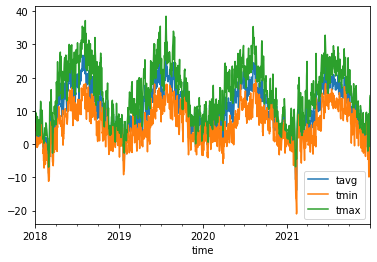

          Timestamp  Room  RoomTemperature  AirqualityPerc  HeaterPerc  \
0  01.01.2018 00:00   0.0        21.299999       -1.252102   -0.333591   
1  01.01.2018 00:15   0.0        21.299999       -1.252102   -0.333591   
2  01.01.2018 00:30   0.0        21.299999       -1.252102   -0.333591   
3  01.01.2018 00:45   0.0        21.299999       -1.252102   -0.333591   
4  01.01.2018 01:00   0.0        21.299999       -1.252102   -0.333591   

   CoolerPerc  TempSupplyAir  RelativeHumiditySupplyAir  HeatingPower  \
0   -0.153382      -1.279037                  -0.855632     -0.462438   
1   -0.153382      -1.326312                  -0.855632     -0.462438   
2   -0.153382      -1.319558                  -0.855632     -0.462438   
3   -0.153382      -1.319558                  -0.899771     -0.462438   
4   -0.153382      -1.319558                  -0.899771     -0.462438   

   CoolingPower  AirTemperature  RelativeHumidity  WindDirection  \
0     -0.076053       -0.270327         -0.99456

In [30]:
# Read data to pandas dataframe
df = pd.read_csv("data/train/data.csv", sep=";")
df = preprocess_df(df)
print(df.head(5))

In [38]:
pandas_profiling.ProfileReport(df, title="Pandas Profiling Report")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

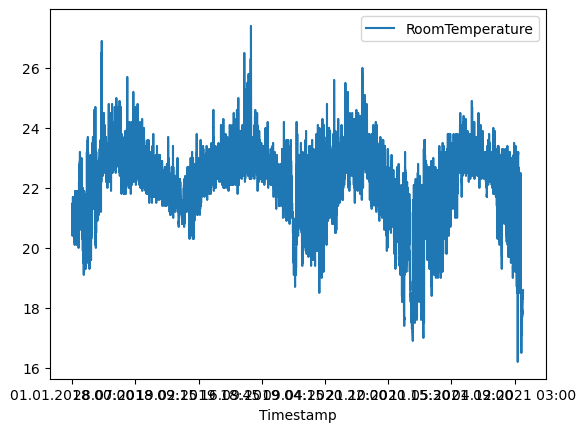

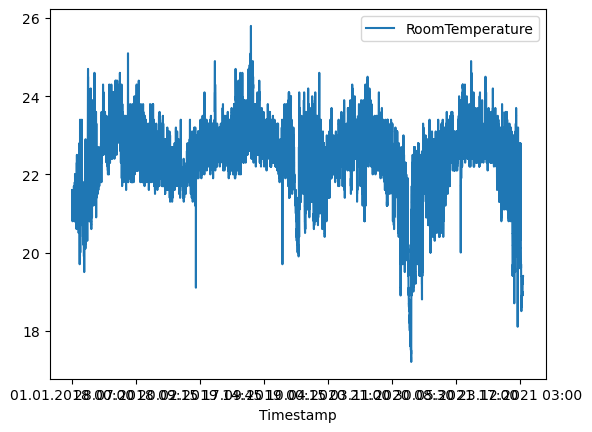

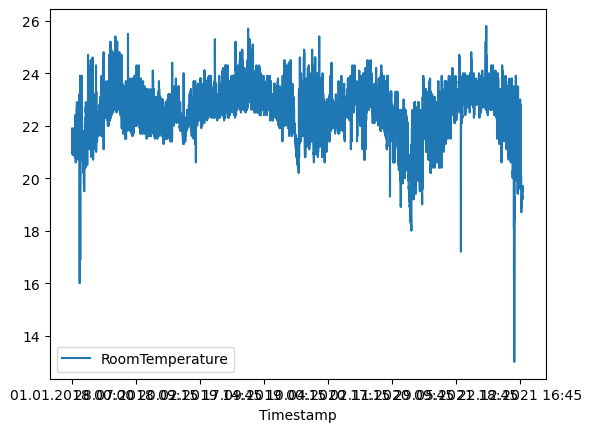

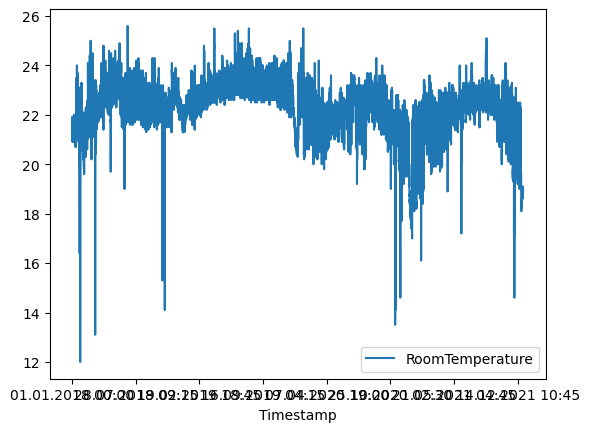

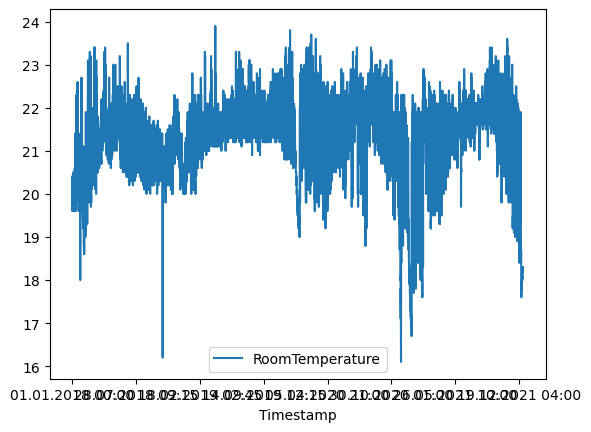

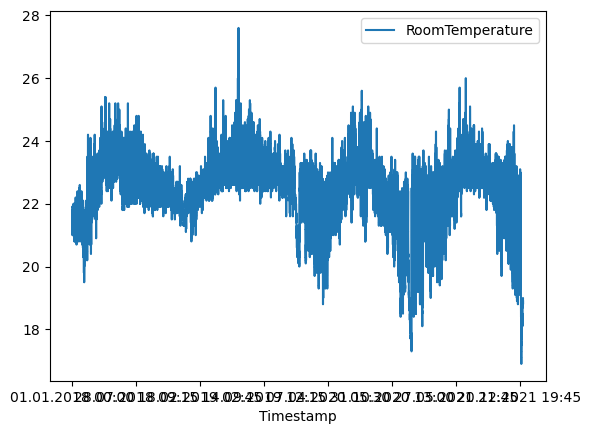

In [28]:
# visualize curves
df["RoomTemperature"] = df["RoomTemperature"].str.replace(',', '.').astype(np.float64)
visualize_rooms(df)